## Visualizing the embeddings

In this notebook I use tSNE and PCA to visualize the corpus and then create wordclouds of the clusters

I first ran a silhouette analysis to decide how many clusters to have. visually there seem to be more than 10 clusters but the scores suggest 8-10.  

I can make out that the text has some difference across clusters. some clusters are old-timey poems, some are very modern. 
But is there a pattern to each cluster,  i do not know enough about the subject to really eyeball the differences. A legit poetry-nerd might find them very illuminating.

In [5]:
import pandas as pd
import pickle

In [6]:
corpus_cache_path = '../data/poem-corpus.pkl'
with open(corpus_cache_path, "rb") as f:
    poems = pickle.load(f) 

In [7]:
poems.dropna(inplace=True)

In [8]:
corpus= poems.to_list()

In [9]:
len(corpus)

16807

In [4]:
df =  pd.DataFrame(poems)

## Dimensionality Reduction 

In [12]:
# For text data, TF-IDF is a great way to represent the data and reduce dimensions

from sklearn.feature_extraction.text import TfidfVectorizer



vectorizer = TfidfVectorizer()
X = vectorizer.fit_transform(corpus)
vectorizer.get_feature_names_out()


array(['00', '000', '000heart', ..., 'ﬂowers', 'ﬂurry', 'ﬂy'],
      dtype=object)

In [14]:
print(X.shape)

(16807, 120316)


In [16]:
from sklearn.manifold import TSNE

# Great for preserving local features of clusters

tsne_model = TSNE(
    init='random',
    perplexity=50,
    n_iter=5000,
    n_iter_without_progress=500,
    metric='euclidean',
)
tsne_embeddings = tsne_model.fit_transform(X)

In [20]:
tsne_embeddings.shape

(16807, 2)

In [17]:
from sklearn.decomposition import TruncatedSVD

#Great for preserving generalized features of the dataset


SVD = TruncatedSVD(n_components=2)  # You can choose the number of components
SVD_embeddings = SVD.fit_transform(X)


In [20]:
len(SVD_embeddings)

16807

In [30]:
from sklearn.cluster import KMeans
import numpy as np

NUM_CLUSTERS = 10
tsne_kmeans = KMeans(n_clusters=NUM_CLUSTERS, max_iter=5000, n_init=1000, random_state=42)

tsne_cluster_labels = tsne_kmeans.fit_predict(tsne_embeddings)

unique_labels, category_sizes = np.unique(tsne_cluster_labels, return_counts=True)

cluster_ids, cluster_sizes = np.unique(tsne_kmeans.labels_, return_counts=True)

print(f"Number of elements assigned to each cluster: {cluster_sizes}")
print(
    "True number of documents in each category according to the class labels: "
    f"{category_sizes}"
)

Number of elements assigned to each cluster: [2137 1732 1509 1735 1632 1221 1309 1854 2512 1166]
True number of documents in each category according to the class labels: [2137 1732 1509 1735 1632 1221 1309 1854 2512 1166]


In [31]:

NUM_CLUSTERS = 10

SVD_kmeans = KMeans(n_clusters=NUM_CLUSTERS, max_iter=5000, n_init=1000, random_state=42)

SVD_cluster_labels = SVD_kmeans.fit_predict(SVD_embeddings)

unique_labels, category_sizes = np.unique(SVD_cluster_labels, return_counts=True)

cluster_ids, cluster_sizes = np.unique(SVD_kmeans.labels_, return_counts=True)


print(f"Number of elements assigned to each cluster: {cluster_sizes}")
print(
    "True number of documents in each category according to the class labels: "
    f"{category_sizes}"
)
 

Number of elements assigned to each cluster: [1002 3055 2376 2089 2366 1264 1181  516 2208  750]
True number of documents in each category according to the class labels: [1002 3055 2376 2089 2366 1264 1181  516 2208  750]


In [28]:
import plotly.express as px

fig = px.scatter(
    x=tsne_embeddings[:, 0], y=tsne_embeddings[:, 1], color=tsne_embeddings[:, 1]
)

fig.update_layout(
    title="t-SNE visualization",
    xaxis_title="First t-SNE",
    yaxis_title="Second t-SNE",
)
fig.show()

I cannot really tell what the differences are in the different SVD clusters. This is strange because both of these are based on TFIDF 

In [32]:
import plotly.express as px

# Create a DataFrame with corpus texts, cluster labels, and corpus IDs
svd_data = {
    'CorpusID': poems.index[:16807],  # Replace with your corpus IDs
    'Cluster': SVD_cluster_labels[:16807],  # Cluster labels from K-Means
    'Text': corpus[:16807]  # Replace with your corpus texts
}
svd_df = pd.DataFrame(svd_data)
svd_df['svd_1'] = SVD_embeddings[:, 0][:16807]
svd_df['svd_2'] = SVD_embeddings[:, 1][:16807]

# Create an interactive scatter plot with Plotly

In [ ]:
fig = px.colors.sequential.swatches()
fig.show()

In [33]:
fig = px.scatter(svd_df, x='svd_1', y='svd_2', color='Cluster', hover_data=['CorpusID'], color_continuous_scale=px.colors.sequential.Agsunset)
fig.update_layout(
    title="SVD Corpus Embeddings Clustering",
    xaxis_title="Dimension 1",
    yaxis_title="Dimension 2"
)
fig.show()

In [95]:
svd_df[svd_df["Cluster"]==1][:10]

,CorpusID,Cluster,Text,svd_1,svd_2
3,3,1,Seder-Night\nby: Israel Zangwill\nurl : https:...,0.176277,-0.047235
11,11,1,Arms and the Boy\nby: Wilfred Owen\nurl : http...,0.246026,-0.057766
16,16,1,Roofs\nby: Stephen Sandy\nurl : https://www.po...,0.191263,-0.070951
22,22,1,Light Shining out of Darkness\nby: William Cow...,0.252497,-0.036385
35,35,1,In Spain\nby: Sir Thomas Wyatt\nurl : https://...,0.186670,-0.023621
49,49,1,The Nonconformist\nby: Donald Davie\nurl : htt...,0.210080,-0.011219
53,53,1,The Amulet\nby: Donald (Grady) Davidson\nurl :...,0.206253,-0.030067
58,58,1,Tally\nby: Josephine Miles\nurl : https://www....,0.260437,-0.086303
72,72,1,Ghost Villanelle\nby: Dan Lechay\nurl : https:...,0.253831,-0.037928
73,73,1,Black Jaguar with Quai Saint-Bernard\nby: Pasc...,0.209564,-0.068706


In [97]:
print(svd_df.iloc[16].Text) #From cluster 1

Roofs
by: Stephen Sandy
url : https://www.poetryfoundation.org/poems/54698/roofs-56d2355915266

Sewn straw, exact pattern. Fields of rice-sprigs
 evenly set, a mile of herringbone tweed.
 The town, a sea of gunmetal, fish-scale tiles.
  
 By morning each floor a casserole of pillows,
 coverlets, comforters, towels:    flown nests. Imprint
 of bodies, fading. They fold the beds away,
 the room waits empty all day.
                                                        All day the bodies
 circle, leaving no impression on each
 other. Tooled in the foundry of the streets.
 School-caps, factory-packed subway, miracle train:
 one territorial imperative,
 an emperor’s.
                           On his platform one yard square
 perched on a roof that slopes in waves of tiles
 up toward other tiled cascades, the karate student
 for  hours does running in place, deep knee bends
 on his surfboard perch. All his free time to make
 his body efficient, tight, exact, rising
 and falling, mint pist

In [96]:
print(svd_df.iloc[11].Text) #From cluster 1

Arms and the Boy
by: Wilfred Owen
url : https://www.poetryfoundation.org/poems/47394/arms-and-the-boy

Let the boy try along this bayonet-blade How cold steel is, and keen with hunger of blood; Blue with all malice, like a madman's flash; And thinly drawn with famishing for flesh.  Lend him to stroke these blind, blunt bullet-leads, Which long to nuzzle in the hearts of lads, Or give him cartridges of fine zinc teeth Sharp with the sharpness of grief and death.  For his teeth seem for laughing round an apple. There lurk no claws behind his fingers supple; And God will grow no talons at his heels, Nor antlers through the thickness of his curls.

++++++++




In [90]:
svd_df[svd_df["Cluster"]==0][:10]

,CorpusID,Cluster,Text,svd_1,svd_2
2,2,0,The Giant Yea\nby: Theodore Weiss\nurl : https...,0.454636,-0.002977
50,50,0,Prayer for the Dead\nby: Stuart Kestenbaum\nur...,0.429041,0.124238
56,56,0,The Best of the Body\nby: Thylias Moss\nurl : ...,0.419187,0.138973
70,70,0,Harp Song of the Dane Women\nby: Rudyard Kipli...,0.456348,-0.003624
82,82,0,Superfly\nby: Lynn Crosbie\nurl : https://www....,0.400248,0.091689
102,102,0,The House\nby: Warsan Shire\nurl : https://www...,0.470597,0.028503
108,108,0,Shooting Star\nby: Arthur Sze\nurl : https://w...,0.430568,0.027655
115,115,0,Berryman\nby: W. S. Merwin\nurl : https://www....,0.411202,0.148471
156,156,0,The Lamps Are Burning\nby: Charles Reznikoff\n...,0.444730,0.029478
180,180,0,On Confessionalism\nby: John Murillo\nurl : ht...,0.427914,0.026743


In [100]:
print(svd_df.iloc[108].Text) #From cluster 0 

Shooting Star
by: Arthur Sze
url : https://www.poetryfoundation.org/poems/50238/shooting-star

1    In a concussion,
       the mind severs the pain:
       you don’t remember flying off a motorcycle,
       and landing face first
       in a cholla. 
       But a woman stabbed in her apartment,
       by a prowler searching for
       money and drugs,
       will never forget her startled shriek
       die in her throat,
       blood soaking into the floor. 
       The quotidian violence of the world
       is like a full moon rising over the Ortiz mountains;
       its pull is everywhere.
       But let me live a life of violent surprise
       and startled joy. I want to
       thrust a purple iris into your hand,
       give you a sudden embrace. 
       I want to live as Wang Hsi-chih lived
       writing characters in gold ink on black silk—
       not to frame on a wall,
       but to live the splendor now.  
 2    Deprived of sleep, she hallucinated
       and, believing she ha

In [102]:
print(svd_df.iloc[180].Text) #From cluster 0

On Confessionalism
by: John Murillo
url : https://www.poetryfoundation.org/poems/155102/on-confessionalism

Not sleepwalking, but waking still,
    with my hand on a gun, and the gun
 in a mouth, and the mouth
    on the face of a man on his knees.
 Autumn of '89, and I'm standing
    in a Section 8 apartment parking lot,
 pistol cocked, and staring down
    at this man, then up into the mug
 of an old woman staring, watering
    the single sad flower to the left
 of her stoop, the flower also staring.
    My engine idling behind me, a slow
 moaning bassline and the bark
    of a dead rapper nudging me on.
 All to say, someone's brokenhearted.
    And this man with the gun in his mouth—
 this man who, like me, is really little
    more than a boy—may or may not
 have something to do with it.
    May or may not have said a thing
 or two, betrayed a secret, say,
    that walked my love away. And why
 not say it: She adored me. And I,
    her. More than anyone, anything
 in life, up to th

I think tsne's clusters are more easy to interpret. there seem to be stylistic and syntactic differnces in the clusters.

In [35]:
import plotly.express as px

# Create a DataFrame with corpus texts, cluster labels, and corpus IDs
tsne_data = {
    'CorpusID': poems.index[:16807],  # Replace with your corpus IDs
    'Cluster': tsne_cluster_labels[:16807],  # Cluster labels from K-Means
    'Text': corpus[:16807]  # 

}
tsne_df = pd.DataFrame(tsne_data)
tsne_df['tsne_1'] = tsne_embeddings[:, 0][:16807]
tsne_df['tsne_2'] = tsne_embeddings[:, 1][:16807]

# Create an interactive scatter plot with Plotly

In [36]:
fig = px.scatter(tsne_df, x='tsne_1', y='tsne_2', color='Cluster', hover_data=['CorpusID'], color_continuous_scale=px.colors.sequential.Agsunset)
fig.update_layout(
    title="t-SNE Corpus Embeddings Clustering",
    xaxis_title="Dimension 1",
    yaxis_title="Dimension 2"
)
fig.show()

In [38]:
tsne_df[tsne_df["Cluster"]==1][:10]

,CorpusID,Cluster,Text,tsne_1,tsne_2
0,0,1,Fianuis\nby: Kathleen Jamie\nurl : https://www...,-19.618080,-2.469445
8,8,1,My baby first birthday\nby: Jenny Zhang\nurl :...,-24.523373,1.196830
18,18,1,JV Wrestling\nby: Joshua Rivkin\nurl : https:/...,-23.002535,-3.374137
25,25,1,The Gentle Art of Shabby Dressing\nby: Spencer...,-25.885670,12.068748
55,55,1,On being asked for a War Poem\nby: William But...,-42.590424,7.817586
72,72,1,Ghost Villanelle\nby: Dan Lechay\nurl : https:...,-18.032690,-3.473486
85,85,1,Bureau of\nby: Joyelle McSweeney\nurl : https:...,-20.119818,8.135784
89,89,1,The Monument and the Shrine\nby: John Logan\nu...,-19.290293,12.782259
110,110,1,Hayden\nby: Amaud Jamaul Johnson\nurl : https:...,-30.737503,6.593112
113,113,1,Letter to Martín Espada\nby: Doug Anderson\nur...,-18.155273,15.837038


In [39]:
tsne_df[tsne_df["Cluster"]==6][:10]

,CorpusID,Cluster,Text,tsne_1,tsne_2
1,1,6,Grieve Not\nby: Walter Clyde Curry\nurl : http...,34.630405,7.988527
14,14,6,To Mr. Henry Lawes\nby: Katherine Philips\nurl...,46.418488,13.792598
35,35,6,In Spain\nby: Sir Thomas Wyatt\nurl : https://...,45.816830,21.975782
42,42,6,from Pamphilia to Amphilanthus: 4\nby: Lady Ma...,55.782429,14.635151
45,45,6,The Silver Swan\nby: Orlando Gibbons\nurl : ht...,38.210388,6.390556
60,60,6,Amoretti LXXI: I joy to see how in your drawen...,49.827717,-8.634609
106,106,6,1492\nby: Emma Lazarus\nurl : https://www.poet...,42.509926,19.559710
112,112,6,Amoretti LV: So oft as I her beauty do behold\...,49.162884,-10.367097
118,118,6,In Memoriam A. H. H. OBIIT MDCCCXXXIII: [Prelu...,48.594749,11.346694
141,141,6,"""Dear, if you change, I'll never choose again""...",41.631538,-8.382644


In [42]:
print(corpus[112])

Amoretti LV: So oft as I her beauty do behold
by: Edmund Spenser
url : https://www.poetryfoundation.org/poems/50272/amoretti-lv-so-oft-as-i-her-beauty-do-behold

So oft as I her beauty do behold,
And therewith do her cruelty compare,
I marvel of what substance was the mould
The which her made at once so cruel-fair.
Not earth; for her high thoughts more heavenly are:
Not water; for her love doth burn like fire:
Not air; for she is not so light or rare:
Not fire; for she doth freeze with faint desire.
 Then needs another element inquire
Whereof she might be made; that is, the sky.
For to the heaven her haughty looks aspire,
And eke her love is pure immortal high.
  Then since to heaven ye likened are the best,
  Be like in mercy as in all the rest.

++++++++




## Wordclouds

In [75]:
# Derived these based on repeated wordcloud making and looking at the stopwords that are by default present 
# in the wordcloud library. I think a lot of the words in these stoplists are relevant to poetry and so i un-stop-worded them


STOPWORDS = [
    "a",
    "all",
    "an",
    "and",
    "are",
    "aren't",
    "as",
    "at",
    "be",
    "but",
    "by",
    "com",
    "d",
    "don't",
    "for",
    "from",
    "https www",
    "https",
    "if",
    "in",
    "is",
    "it",
    "it's",
    "its",
    "let's",
    "like a",
    "like",
    "of a",
    "of",
    "on",
    "or",
    "org poems",
    "org poetrymagazine",
    "org",
    "our",
    "ours",
    "poems",
    "poetryfoundation org",
    "poetryfoundation",
    "poetrymagazine poems",
    "poetrymagazine",
    "s",
    "so",
    "than",
    "that",
    "that's",
    "the",
    "their",
    "then",
    "thi",
    "this",
    "to be",
    "to",
    "too",
    "url https",
    "url",
    "with",
    "www",
]

In [74]:
wordcloud.words_.keys()

dict_keys(['this', 'my', 'you', 'hi', 'her', 'me', 'one', 'there', 'your', 'not', 'wa', 'out', 'into', 'he', 'what', 'now', 'light', 'love', 'when', 'through', 'no', 'them', 'up', 'where', 'we', 'they', 'over', 'day', 'night', 'u', 'which', 'still', 'only', 'she', 'I am', 'time', 'some', 'down', 'him', 'man', 'water', 'world', 'here', 'more', 'eye', 'thing', 'just', 'back', 'word', 'after', 'God', 'tree', 'white', 'hand', 'come', 'black', 'say', 'sun', 'life', 'dark', 'little', 'way', 'how', 'I wa', 'air', 'long', 'wind', 'make', 'even', 'old', 'these', 'leave', 'who', 'don t', 'face', 'house', 'I m', 'two', 'were', 'dead', 'earth', 'other', 'first', 'sky', 'heart', 'again', 'sea', 'death', 'new', 'blue', 'dream', 'when I', 'I have', 'under', 'each', 'those', 'song', 'nothing', 'off', 'before', 'body', 'away', 'yet', 'good', 'look', 'bird', 'place', 'thy', 'every', 'end', 'something', 'while', 'without', 'last', 'green', 'sound', 'once', 'men', 'fire', 'red', 'star', 'name', 'home', 'l

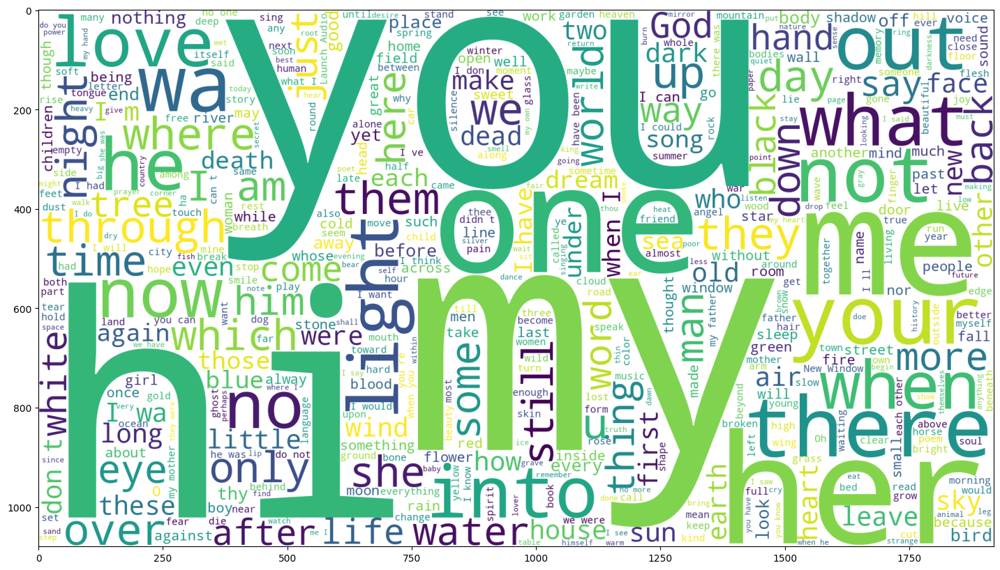

In [76]:
from  wordcloud import WordCloud
import matplotlib.pyplot as plt
wordcloud = WordCloud(background_color="white",width=1920, height=1080, max_words =500, stopwords=STOPWORDS).generate(' '.join(tsne_df.Text.tolist()))
plt.figure(figsize=(20,10))
plt.imshow(wordcloud)

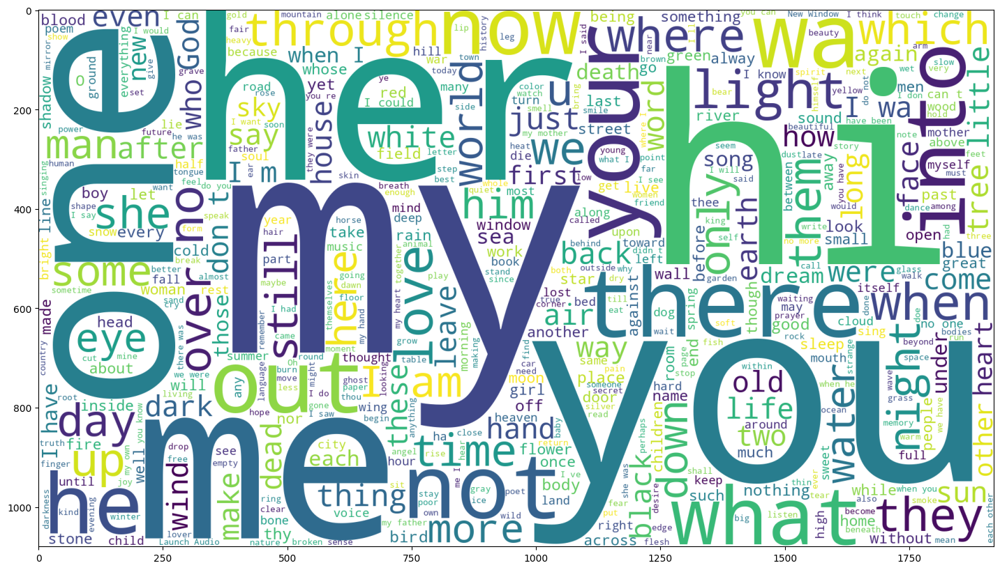

In [77]:
from  wordcloud import WordCloud
import matplotlib.pyplot as plt
wordcloud = WordCloud(background_color="white",width=1920, height=1080, max_words =500, stopwords=STOPWORDS).generate(' '.join(svd_df.Text.tolist()))
plt.figure(figsize=(20,10))
plt.imshow(wordcloud)

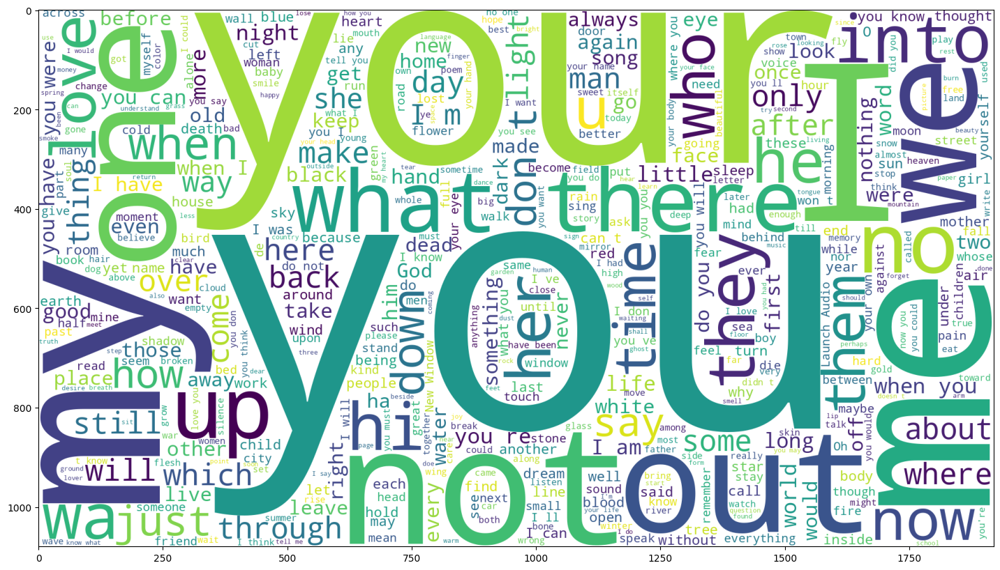

In [78]:
from  wordcloud import WordCloud
import matplotlib.pyplot as plt
wordcloud = WordCloud(background_color="white",width=1920, height=1080, max_words =500, stopwords=STOPWORDS).generate(' '.join(tsne_df[tsne_df.Cluster==0].Text.tolist()))
plt.figure(figsize=(20,10))
plt.imshow(wordcloud)

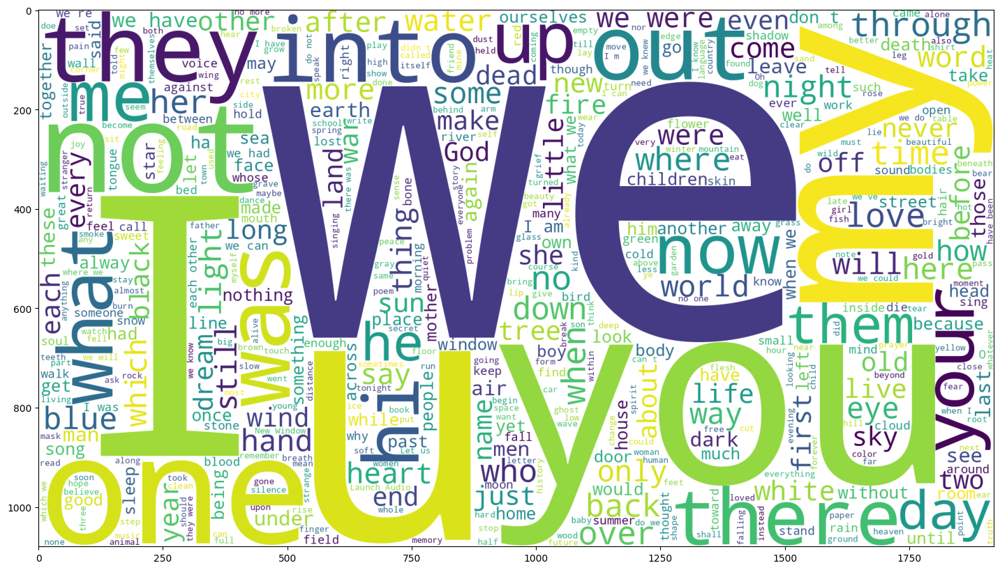

In [79]:
from  wordcloud import WordCloud
import matplotlib.pyplot as plt
wordcloud = WordCloud(background_color="white",width=1920, height=1080, max_words =500, stopwords=STOPWORDS).generate(' '.join(tsne_df[tsne_df.Cluster==1].Text.tolist()))
plt.figure(figsize=(20,10))
plt.imshow(wordcloud)

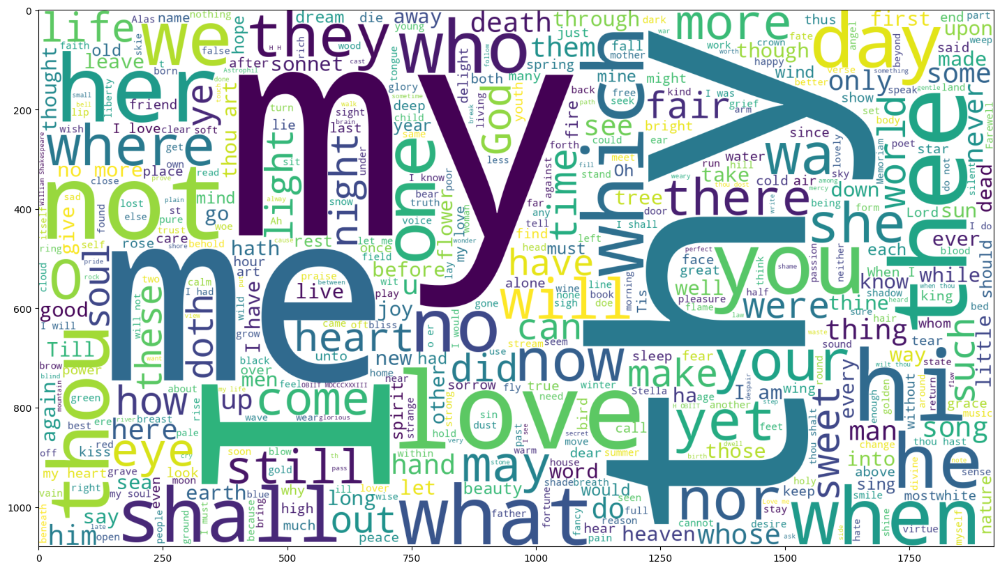

In [80]:
from  wordcloud import WordCloud
import matplotlib.pyplot as plt
wordcloud = WordCloud(background_color="white",width=1920, height=1080, max_words =500, stopwords=STOPWORDS).generate(' '.join(tsne_df[tsne_df.Cluster==6].Text.tolist()))
plt.figure(figsize=(20,10))
plt.imshow(wordcloud)

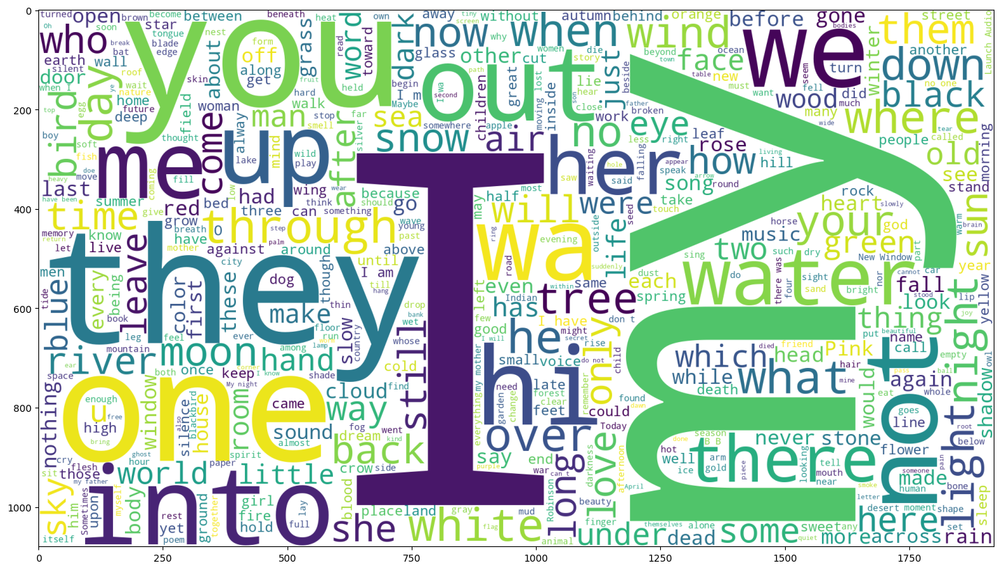

In [81]:
from  wordcloud import WordCloud
import matplotlib.pyplot as plt
wordcloud = WordCloud(background_color="white",width=1920, height=1080, max_words =500, stopwords=STOPWORDS).generate(' '.join(tsne_df[tsne_df.Cluster==9].Text.tolist()))
plt.figure(figsize=(20,10))
plt.imshow(wordcloud)

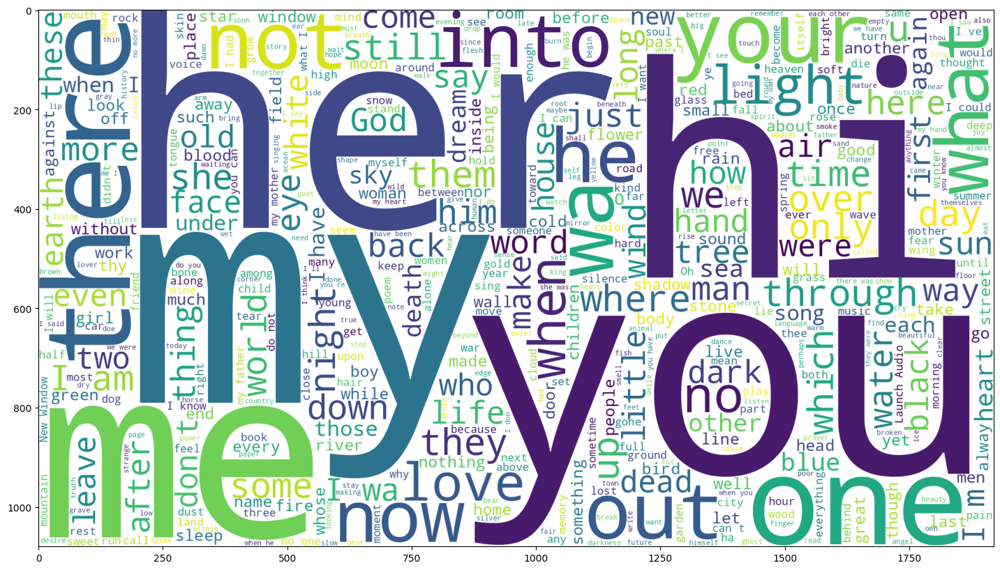

In [83]:
from  wordcloud import WordCloud
import matplotlib.pyplot as plt
wordcloud = WordCloud(background_color="white",width=1920, height=1080, max_words =500, stopwords=STOPWORDS).generate(' '.join(svd_df.Text.tolist()))
plt.figure(figsize=(20,10))
plt.imshow(wordcloud)

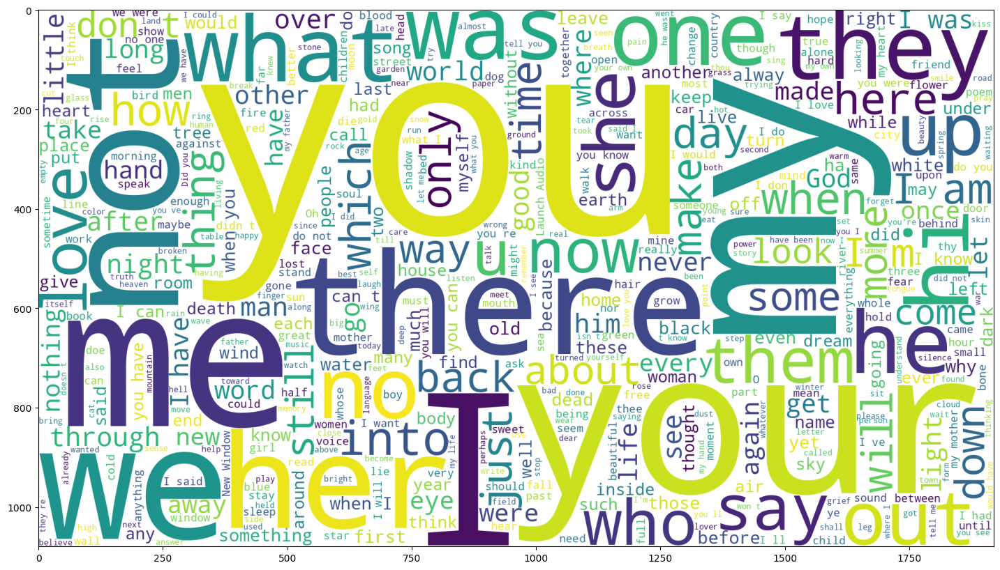

In [82]:
from  wordcloud import WordCloud
import matplotlib.pyplot as plt
wordcloud = WordCloud(background_color="white",width=1920, height=1080, max_words =500, stopwords=STOPWORDS).generate(' '.join(svd_df[svd_df.Cluster==6].Text.tolist()))
plt.figure(figsize=(20,10))
plt.imshow(wordcloud)

## Silhouette analysis

Shows that around 8-10 clusters have the best fit

For n_clusters = 2 The average silhouette_score is : 0.36401644
For n_clusters = 3 The average silhouette_score is : 0.37699685
For n_clusters = 4 The average silhouette_score is : 0.34622365
For n_clusters = 5 The average silhouette_score is : 0.34940785
For n_clusters = 6 The average silhouette_score is : 0.33604762
For n_clusters = 7 The average silhouette_score is : 0.38244373


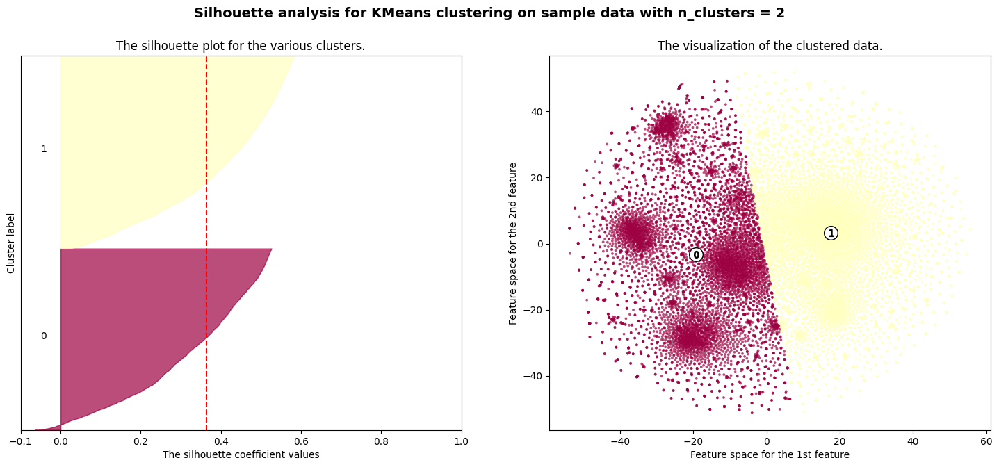

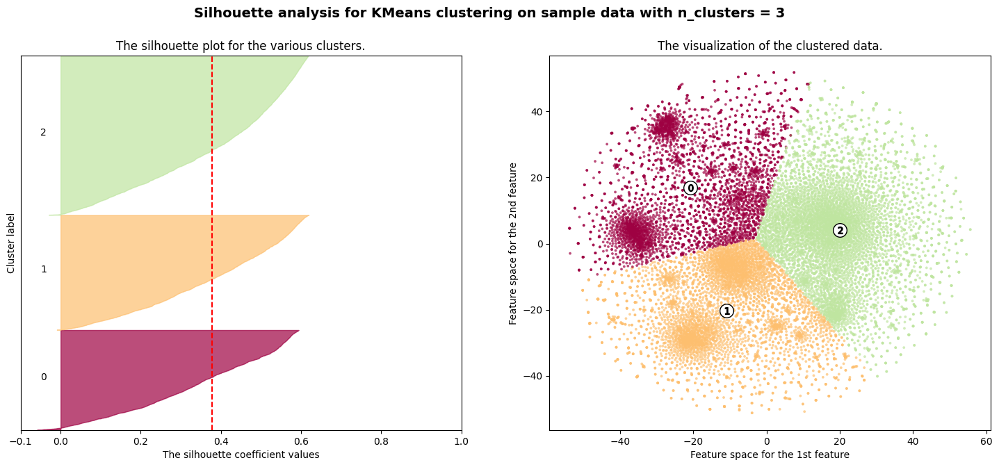

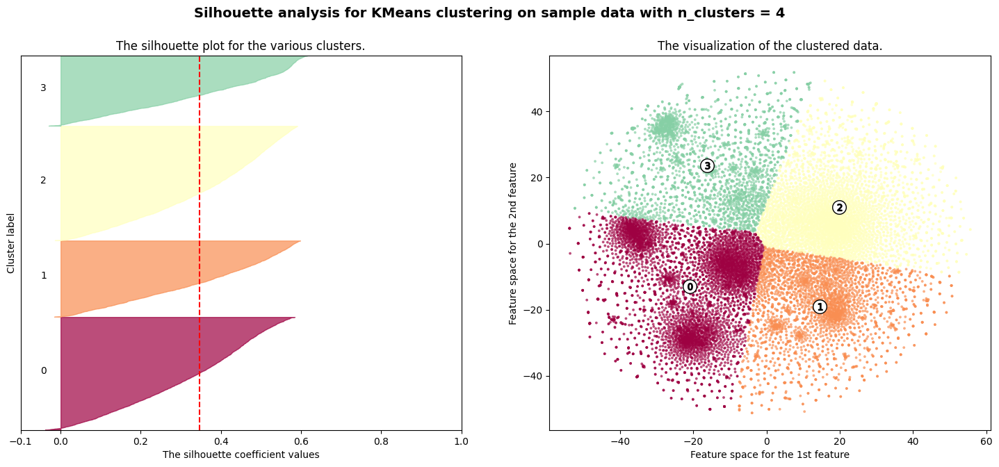

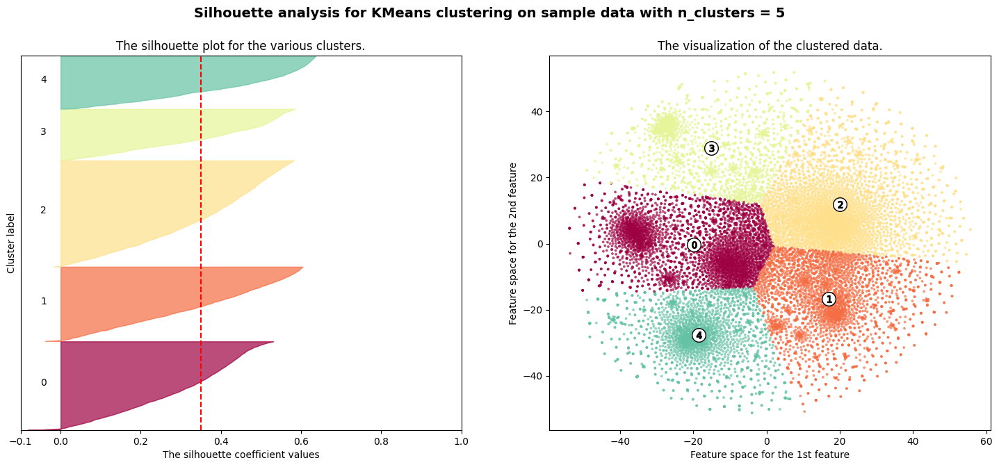

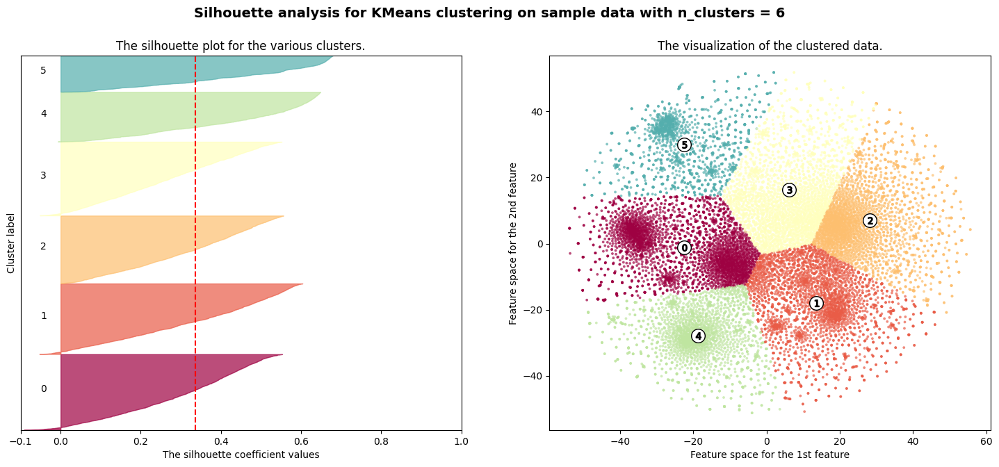

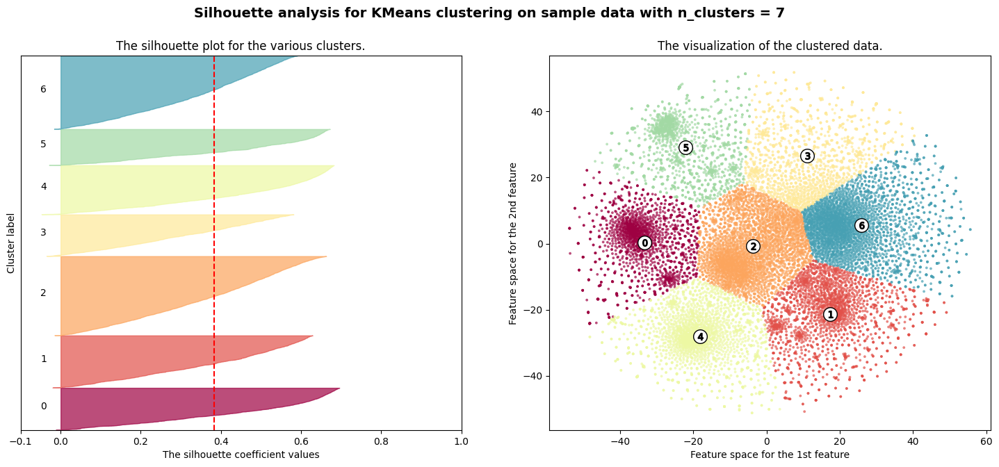

In [38]:
import matplotlib.cm as cm
import matplotlib.pyplot as plt
import numpy as np

from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_samples, silhouette_score

# Generating the sample data from make_blobs
# This particular setting has one distinct cluster and 3 clusters placed close
# together.

range_n_clusters = [2,3,4,5,6,7]

for n_clusters in range_n_clusters:
    # Create a subplot with 1 row and 2 columns
    fig, (ax1, ax2) = plt.subplots(1, 2)
    fig.set_size_inches(18, 7)

    # The 1st subplot is the silhouette plot
    # The silhouette coefficient can range from -1, 1 but in this example all
    # lie within [-0.1, 1]
    ax1.set_xlim([-0.1, 1])
    # The (n_clusters+1)*10 is for inserting blank space between silhouette
    # plots of individual clusters, to demarcate them clearly.
    ax1.set_ylim([0, len(tsne_embeddings) + (n_clusters + 1) * 10])

    # Initialize the clusterer with n_clusters value and a random generator

    clusterer = KMeans(n_clusters=n_clusters, n_init="auto", random_state=42)
    cluster_labels = clusterer.fit_predict(tsne_embeddings)

    # The silhouette_score gives the average value for all the samples.
    # This gives a perspective into the density and separation of the formed
    # clusters
    silhouette_avg = silhouette_score(tsne_embeddings, cluster_labels)
    print(
        "For n_clusters =",
        n_clusters,
        "The average silhouette_score is :",
        silhouette_avg,
    )

    # Compute the silhouette scores for each sample
    sample_silhouette_values = silhouette_samples(tsne_embeddings, cluster_labels)

    y_lower = 10
    for i in range(n_clusters):
        # Aggregate the silhouette scores for samples belonging to
        # cluster i, and sort them
        ith_cluster_silhouette_values = sample_silhouette_values[cluster_labels == i]

        ith_cluster_silhouette_values.sort()

        size_cluster_i = ith_cluster_silhouette_values.shape[0]
        y_upper = y_lower + size_cluster_i

        color = cm.Spectral(float(i) / n_clusters)
        ax1.fill_betweenx(
            np.arange(y_lower, y_upper),
            0,
            ith_cluster_silhouette_values,
            facecolor=color,
            edgecolor=color,
            alpha=0.7,
        )

        # Label the silhouette plots with their cluster numbers at the middle
        ax1.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))

        # Compute the new y_lower for next plot
        y_lower = y_upper + 10  # 10 for the 0 samples

    ax1.set_title("The silhouette plot for the various clusters.")
    ax1.set_xlabel("The silhouette coefficient values")
    ax1.set_ylabel("Cluster label")

    # The vertical line for average silhouette score of all the values
    ax1.axvline(x=silhouette_avg, color="red", linestyle="--")

    ax1.set_yticks([])  # Clear the yaxis labels / ticks
    ax1.set_xticks([-0.1, 0, 0.2, 0.4, 0.6, 0.8, 1])

    # 2nd Plot showing the actual clusters formed
    colors = cm.Spectral(cluster_labels.astype(float) / n_clusters)
    ax2.scatter(
        tsne_embeddings[:, 0], tsne_embeddings[:, 1], marker=".", s=30, lw=0, alpha=0.7, c=colors, edgecolor="k"
    )

    # Labeling the clusters
    centers = clusterer.cluster_centers_
    # Draw white circles at cluster centers
    ax2.scatter(
        centers[:, 0],
        centers[:, 1],
        marker="o",
        c="white",
        alpha=1,
        s=200,
        edgecolor="k",
    )

    for i, c in enumerate(centers):
        ax2.scatter(c[0], c[1], marker="$%d$" % i, alpha=1, s=50, edgecolor="k")

    ax2.set_title("The visualization of the clustered data.")
    ax2.set_xlabel("Feature space for the 1st feature")
    ax2.set_ylabel("Feature space for the 2nd feature")

    plt.suptitle(
        "Silhouette analysis for KMeans clustering on sample data with n_clusters = %d"
        % n_clusters,
        fontsize=14,
        fontweight="bold",
    )

plt.show()

For n_clusters = 6 The average silhouette_score is : 0.33604762
For n_clusters = 10 The average silhouette_score is : 0.38667354
For n_clusters = 15 The average silhouette_score is : 0.35875592
For n_clusters = 20 The average silhouette_score is : 0.35780367
For n_clusters = 50 The average silhouette_score is : 0.32696524


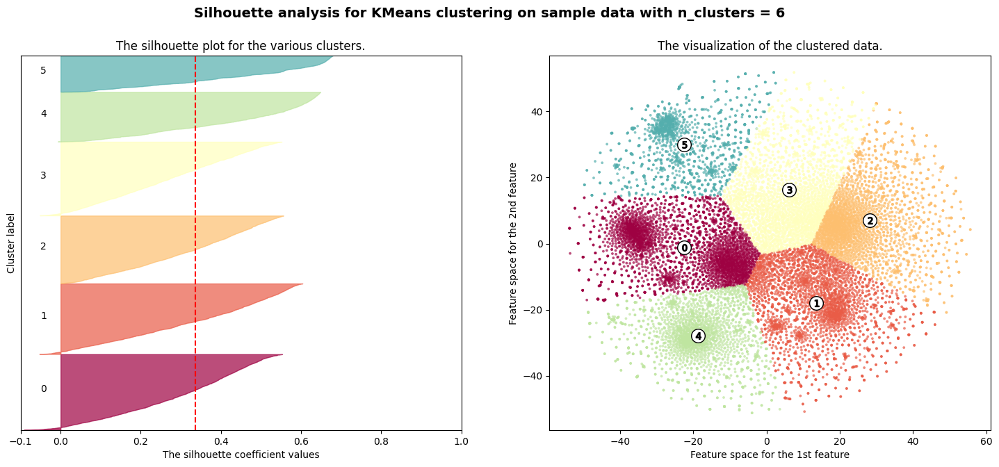

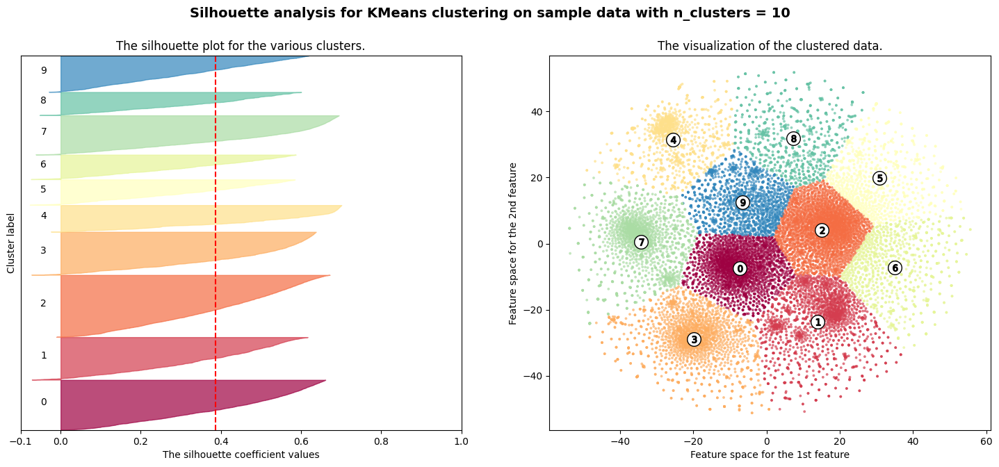

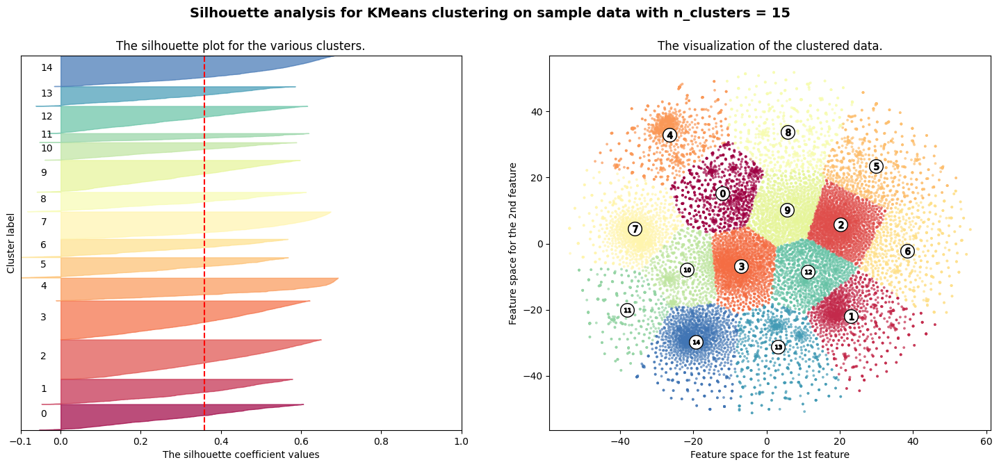

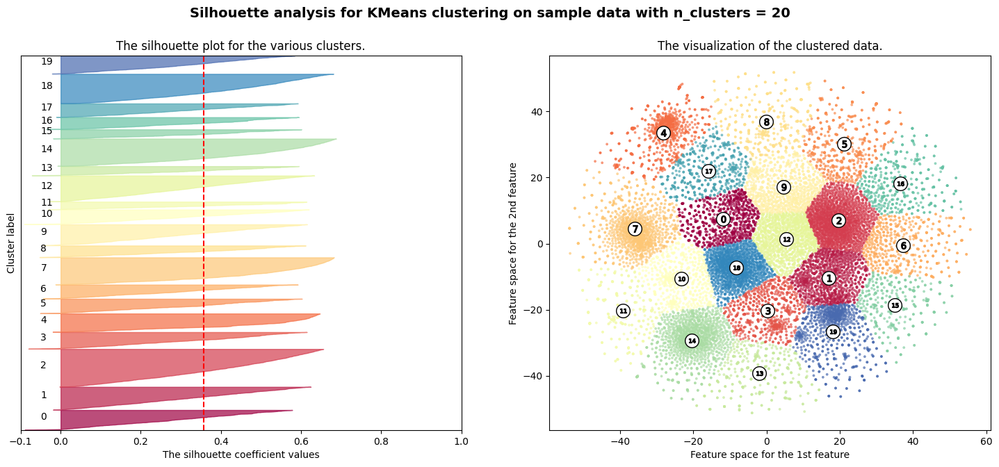

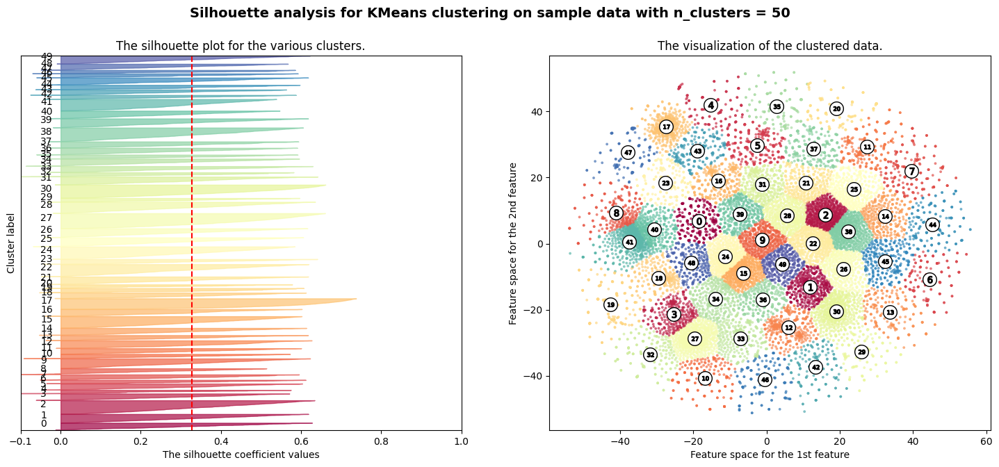

In [39]:
import matplotlib.cm as cm
import matplotlib.pyplot as plt
import numpy as np

from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_samples, silhouette_score

# Generating the sample data from make_blobs
# This particular setting has one distinct cluster and 3 clusters placed close
# together.

range_n_clusters = [6, 10, 15, 20, 50]

for n_clusters in range_n_clusters:
    # Create a subplot with 1 row and 2 columns
    fig, (ax1, ax2) = plt.subplots(1, 2)
    fig.set_size_inches(18, 7)

    # The 1st subplot is the silhouette plot
    # The silhouette coefficient can range from -1, 1 but in this example all
    # lie within [-0.1, 1]
    ax1.set_xlim([-0.1, 1])
    # The (n_clusters+1)*10 is for inserting blank space between silhouette
    # plots of individual clusters, to demarcate them clearly.
    ax1.set_ylim([0, len(tsne_embeddings) + (n_clusters + 1) * 10])

    # Initialize the clusterer with n_clusters value and a random generator

    clusterer = KMeans(n_clusters=n_clusters, n_init="auto", random_state=42)
    cluster_labels = clusterer.fit_predict(tsne_embeddings)

    # The silhouette_score gives the average value for all the samples.
    # This gives a perspective into the density and separation of the formed
    # clusters
    silhouette_avg = silhouette_score(tsne_embeddings, cluster_labels)
    print(
        "For n_clusters =",
        n_clusters,
        "The average silhouette_score is :",
        silhouette_avg,
    )

    # Compute the silhouette scores for each sample
    sample_silhouette_values = silhouette_samples(tsne_embeddings, cluster_labels)

    y_lower = 10
    for i in range(n_clusters):
        # Aggregate the silhouette scores for samples belonging to
        # cluster i, and sort them
        ith_cluster_silhouette_values = sample_silhouette_values[cluster_labels == i]

        ith_cluster_silhouette_values.sort()

        size_cluster_i = ith_cluster_silhouette_values.shape[0]
        y_upper = y_lower + size_cluster_i

        color = cm.Spectral(float(i) / n_clusters)
        ax1.fill_betweenx(
            np.arange(y_lower, y_upper),
            0,
            ith_cluster_silhouette_values,
            facecolor=color,
            edgecolor=color,
            alpha=0.7,
        )

        # Label the silhouette plots with their cluster numbers at the middle
        ax1.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))

        # Compute the new y_lower for next plot
        y_lower = y_upper + 10  # 10 for the 0 samples

    ax1.set_title("The silhouette plot for the various clusters.")
    ax1.set_xlabel("The silhouette coefficient values")
    ax1.set_ylabel("Cluster label")

    # The vertical line for average silhouette score of all the values
    ax1.axvline(x=silhouette_avg, color="red", linestyle="--")

    ax1.set_yticks([])  # Clear the yaxis labels / ticks
    ax1.set_xticks([-0.1, 0, 0.2, 0.4, 0.6, 0.8, 1])

    # 2nd Plot showing the actual clusters formed
    colors = cm.Spectral(cluster_labels.astype(float) / n_clusters)
    ax2.scatter(
        tsne_embeddings[:, 0],
        tsne_embeddings[:, 1],
        marker=".",
        s=30,
        lw=0,
        alpha=0.7,
        c=colors,
        edgecolor="k",
    )

    # Labeling the clusters
    centers = clusterer.cluster_centers_
    # Draw white circles at cluster centers
    ax2.scatter(
        centers[:, 0],
        centers[:, 1],
        marker="o",
        c="white",
        alpha=1,
        s=200,
        edgecolor="k",
    )

    for i, c in enumerate(centers):
        ax2.scatter(c[0], c[1], marker="$%d$" % i, alpha=1, s=50, edgecolor="k")

    ax2.set_title("The visualization of the clustered data.")
    ax2.set_xlabel("Feature space for the 1st feature")
    ax2.set_ylabel("Feature space for the 2nd feature")

    plt.suptitle(
        "Silhouette analysis for KMeans clustering on sample data with n_clusters = %d"
        % n_clusters,
        fontsize=14,
        fontweight="bold",
    )

plt.show()

For n_clusters = 2 The average silhouette_score is : 0.3603141155615212
For n_clusters = 3 The average silhouette_score is : 0.3986361565242624
For n_clusters = 4 The average silhouette_score is : 0.35115746554918853
For n_clusters = 5 The average silhouette_score is : 0.34342004464430603
For n_clusters = 6 The average silhouette_score is : 0.3125044577996828


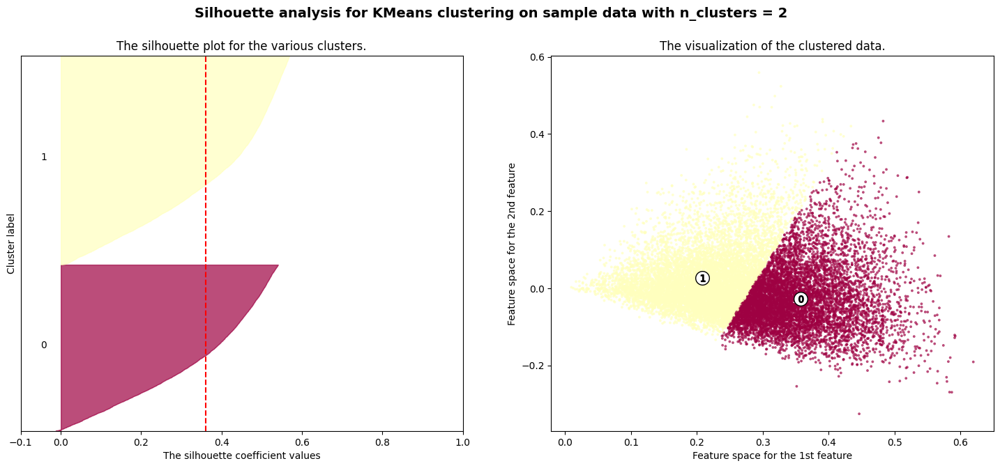

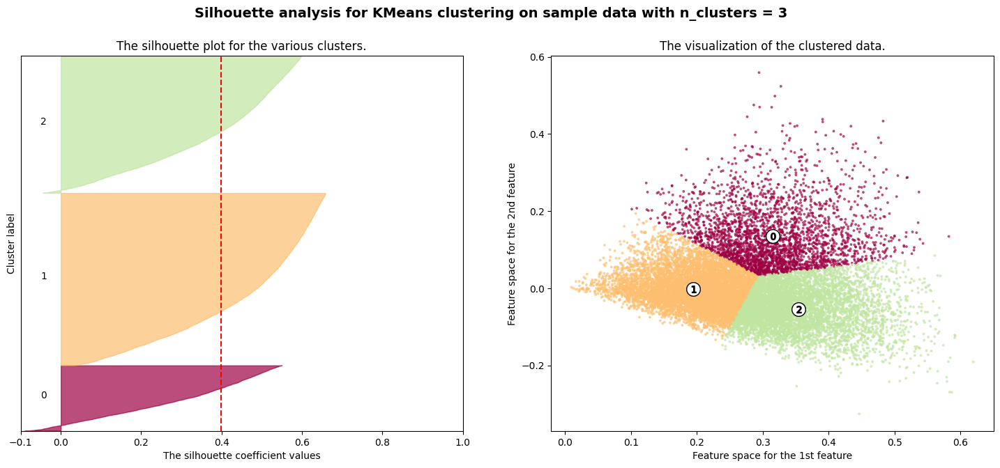

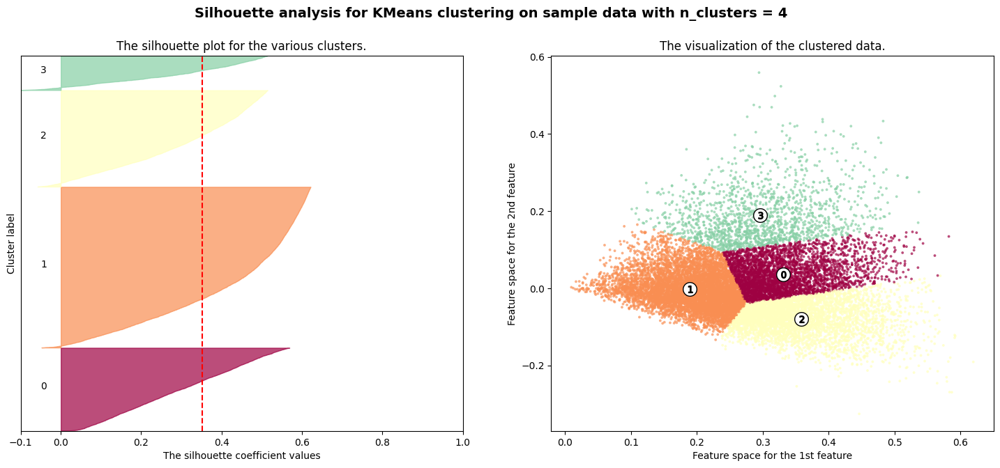

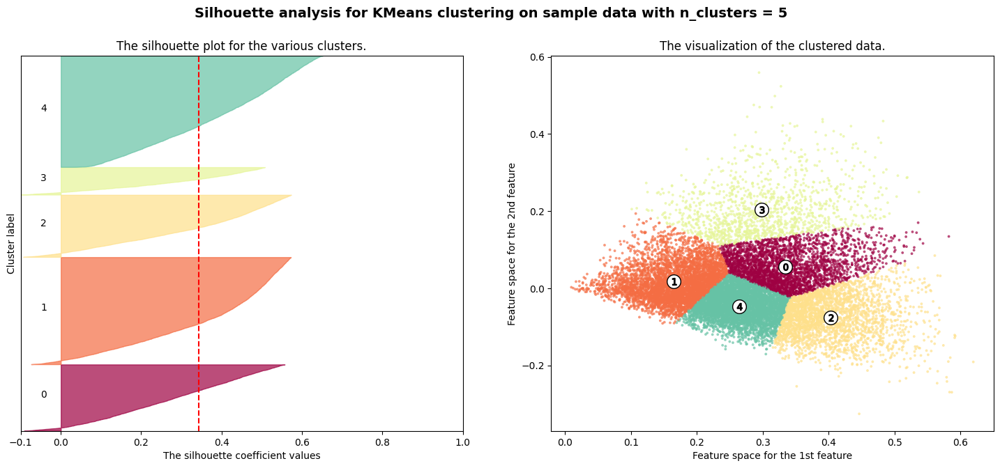

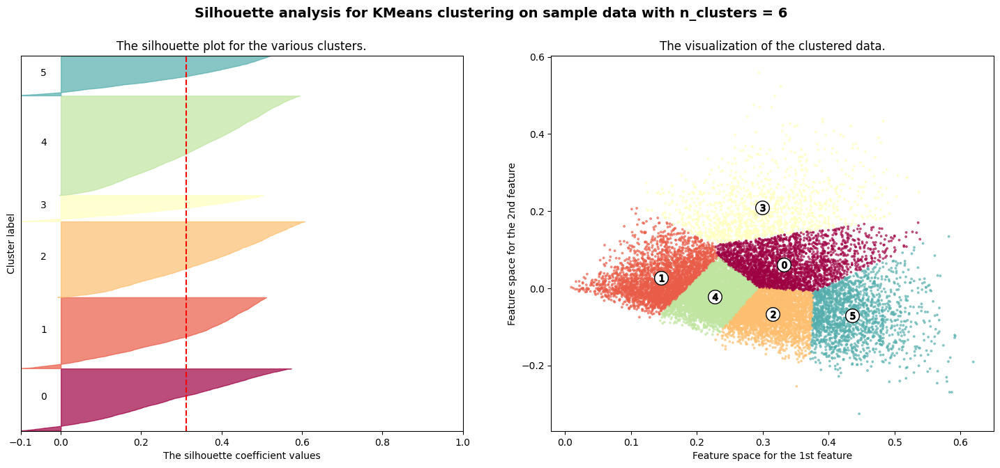

In [40]:
import matplotlib.cm as cm
import matplotlib.pyplot as plt
import numpy as np

from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_samples, silhouette_score

# Generating the sample data from make_blobs
# This particular setting has one distinct cluster and 3 clusters placed close
# together.

range_n_clusters = [2,3,4,5,6]

for n_clusters in range_n_clusters:
    # Create a subplot with 1 row and 2 columns
    fig, (ax1, ax2) = plt.subplots(1, 2)
    fig.set_size_inches(18, 7)

    # The 1st subplot is the silhouette plot
    # The silhouette coefficient can range from -1, 1 but in this example all
    # lie within [-0.1, 1]
    ax1.set_xlim([-0.1, 1])
    # The (n_clusters+1)*10 is for inserting blank space between silhouette
    # plots of individual clusters, to demarcate them clearly.
    ax1.set_ylim([0, len(SVD_embeddings) + (n_clusters + 1) * 10])

    # Initialize the clusterer with n_clusters value and a random generator
    # seed of 10 for reproducibility.
    clusterer = KMeans(n_clusters=n_clusters, n_init="auto", random_state=10)
    cluster_labels = clusterer.fit_predict(SVD_embeddings)

    # The silhouette_score gives the average value for all the samples.
    # This gives a perspective into the density and separation of the formed
    # clusters
    silhouette_avg = silhouette_score(SVD_embeddings, cluster_labels)
    print(
        "For n_clusters =",
        n_clusters,
        "The average silhouette_score is :",
        silhouette_avg,
    )

    # Compute the silhouette scores for each sample
    sample_silhouette_values = silhouette_samples(SVD_embeddings, cluster_labels)

    y_lower = 10
    for i in range(n_clusters):
        # Aggregate the silhouette scores for samples belonging to
        # cluster i, and sort them
        ith_cluster_silhouette_values = sample_silhouette_values[cluster_labels == i]

        ith_cluster_silhouette_values.sort()

        size_cluster_i = ith_cluster_silhouette_values.shape[0]
        y_upper = y_lower + size_cluster_i

        color = cm.Spectral(float(i) / n_clusters)
        ax1.fill_betweenx(
            np.arange(y_lower, y_upper),
            0,
            ith_cluster_silhouette_values,
            facecolor=color,
            edgecolor=color,
            alpha=0.7,
        )

        # Label the silhouette plots with their cluster numbers at the middle
        ax1.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))

        # Compute the new y_lower for next plot
        y_lower = y_upper + 10  # 10 for the 0 samples

    ax1.set_title("The silhouette plot for the various clusters.")
    ax1.set_xlabel("The silhouette coefficient values")
    ax1.set_ylabel("Cluster label")

    # The vertical line for average silhouette score of all the values
    ax1.axvline(x=silhouette_avg, color="red", linestyle="--")

    ax1.set_yticks([])  # Clear the yaxis labels / ticks
    ax1.set_xticks([-0.1, 0, 0.2, 0.4, 0.6, 0.8, 1])

    # 2nd Plot showing the actual clusters formed
    colors = cm.Spectral(cluster_labels.astype(float) / n_clusters)
    ax2.scatter(
        SVD_embeddings[:, 0], SVD_embeddings[:, 1], marker=".", s=30, lw=0, alpha=0.7, c=colors, edgecolor="k"
    )

    # Labeling the clusters
    centers = clusterer.cluster_centers_
    # Draw white circles at cluster centers
    ax2.scatter(
        centers[:, 0],
        centers[:, 1],
        marker="o",
        c="white",
        alpha=1,
        s=200,
        edgecolor="k",
    )

    for i, c in enumerate(centers):
        ax2.scatter(c[0], c[1], marker="$%d$" % i, alpha=1, s=50, edgecolor="k")

    ax2.set_title("The visualization of the clustered data.")
    ax2.set_xlabel("Feature space for the 1st feature")
    ax2.set_ylabel("Feature space for the 2nd feature")

    plt.suptitle(
        "Silhouette analysis for KMeans clustering on sample data with n_clusters = %d"
        % n_clusters,
        fontsize=14,
        fontweight="bold",
    )

plt.show()

For n_clusters = 6 The average silhouette_score is : 0.32798937
For n_clusters = 10 The average silhouette_score is : 0.32461056
For n_clusters = 20 The average silhouette_score is : 0.3156462
For n_clusters = 50 The average silhouette_score is : 0.31828392
For n_clusters = 100 The average silhouette_score is : 0.32187092


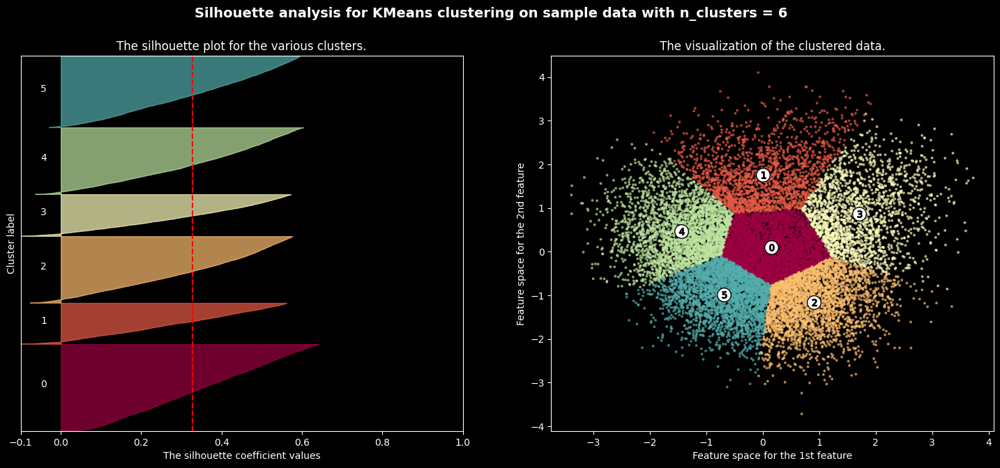

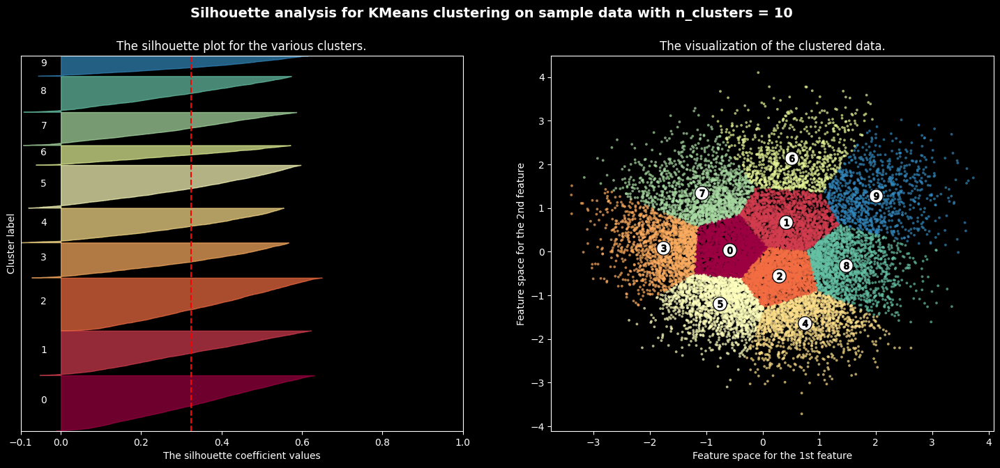

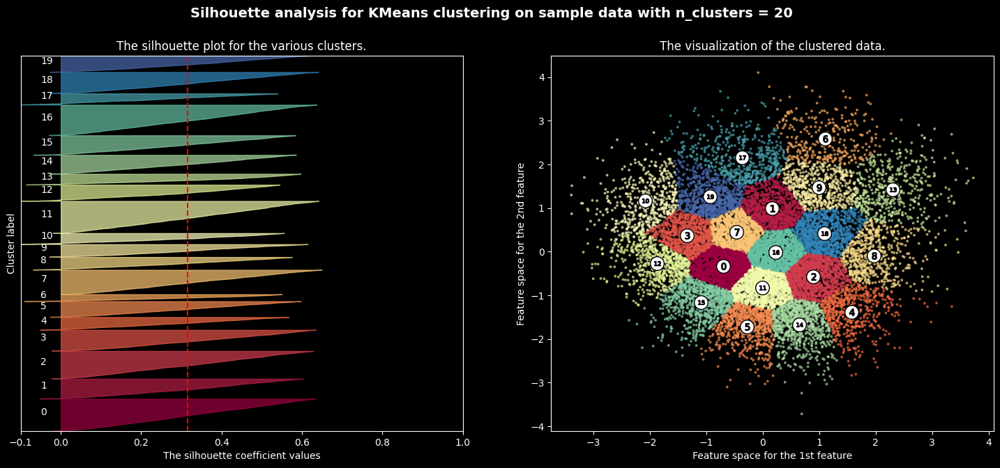

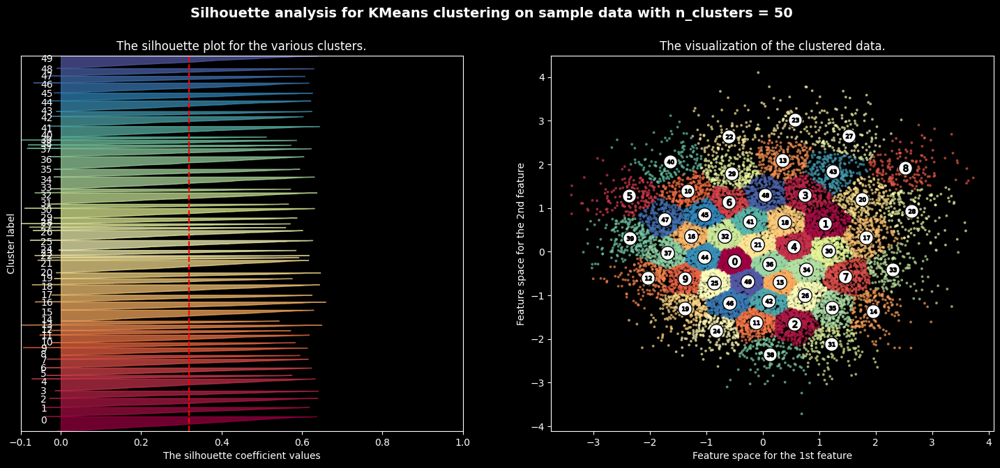

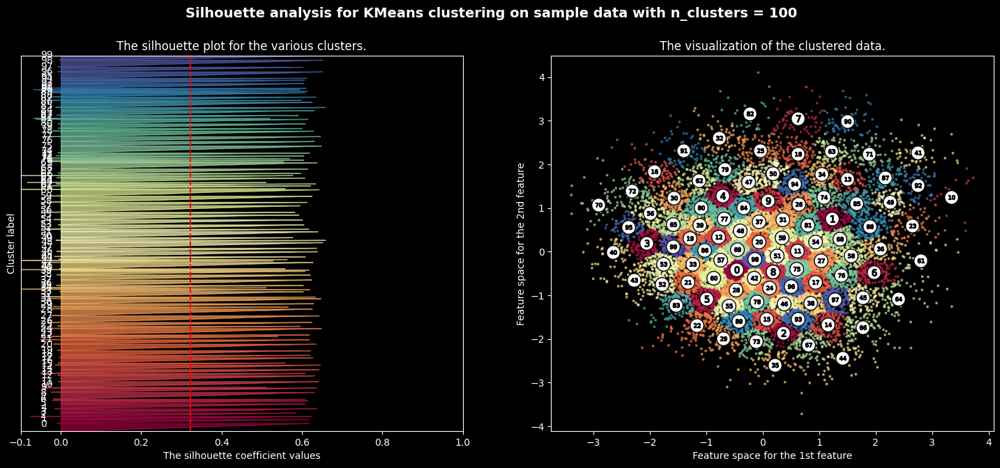

In [27]:
import matplotlib.cm as cm
import matplotlib.pyplot as plt
import numpy as np

from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_samples, silhouette_score

# Generating the sample data from make_blobs
# This particular setting has one distinct cluster and 3 clusters placed close
# together.

range_n_clusters = [6, 10,20,50,100]

for n_clusters in range_n_clusters:
    # Create a subplot with 1 row and 2 columns
    fig, (ax1, ax2) = plt.subplots(1, 2)
    fig.set_size_inches(18, 7)

    # The 1st subplot is the silhouette plot
    # The silhouette coefficient can range from -1, 1 but in this example all
    # lie within [-0.1, 1]
    ax1.set_xlim([-0.1, 1])
    # The (n_clusters+1)*10 is for inserting blank space between silhouette
    # plots of individual clusters, to demarcate them clearly.
    ax1.set_ylim([0, len(pca_embeddings) + (n_clusters + 1) * 10])

    # Initialize the clusterer with n_clusters value and a random generator
    # seed of 10 for reproducibility.
    clusterer = KMeans(n_clusters=n_clusters, n_init="auto", random_state=10)
    cluster_labels = clusterer.fit_predict(pca_embeddings)

    # The silhouette_score gives the average value for all the samples.
    # This gives a perspective into the density and separation of the formed
    # clusters
    silhouette_avg = silhouette_score(pca_embeddings, cluster_labels)
    print(
        "For n_clusters =",
        n_clusters,
        "The average silhouette_score is :",
        silhouette_avg,
    )

    # Compute the silhouette scores for each sample
    sample_silhouette_values = silhouette_samples(pca_embeddings, cluster_labels)

    y_lower = 10
    for i in range(n_clusters):
        # Aggregate the silhouette scores for samples belonging to
        # cluster i, and sort them
        ith_cluster_silhouette_values = sample_silhouette_values[cluster_labels == i]

        ith_cluster_silhouette_values.sort()

        size_cluster_i = ith_cluster_silhouette_values.shape[0]
        y_upper = y_lower + size_cluster_i

        color = cm.Spectral(float(i) / n_clusters)
        ax1.fill_betweenx(
            np.arange(y_lower, y_upper),
            0,
            ith_cluster_silhouette_values,
            facecolor=color,
            edgecolor=color,
            alpha=0.7,
        )

        # Label the silhouette plots with their cluster numbers at the middle
        ax1.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))

        # Compute the new y_lower for next plot
        y_lower = y_upper + 10  # 10 for the 0 samples

    ax1.set_title("The silhouette plot for the various clusters.")
    ax1.set_xlabel("The silhouette coefficient values")
    ax1.set_ylabel("Cluster label")

    # The vertical line for average silhouette score of all the values
    ax1.axvline(x=silhouette_avg, color="red", linestyle="--")

    ax1.set_yticks([])  # Clear the yaxis labels / ticks
    ax1.set_xticks([-0.1, 0, 0.2, 0.4, 0.6, 0.8, 1])

    # 2nd Plot showing the actual clusters formed
    colors = cm.Spectral(cluster_labels.astype(float) / n_clusters)
    ax2.scatter(
        pca_embeddings[:, 0], pca_embeddings[:, 1], marker=".", s=30, lw=0, alpha=0.7, c=colors, edgecolor="k"
    )

    # Labeling the clusters
    centers = clusterer.cluster_centers_
    # Draw white circles at cluster centers
    ax2.scatter(
        centers[:, 0],
        centers[:, 1],
        marker="o",
        c="white",
        alpha=1,
        s=200,
        edgecolor="k",
    )

    for i, c in enumerate(centers):
        ax2.scatter(c[0], c[1], marker="$%d$" % i, alpha=1, s=50, edgecolor="k")

    ax2.set_title("The visualization of the clustered data.")
    ax2.set_xlabel("Feature space for the 1st feature")
    ax2.set_ylabel("Feature space for the 2nd feature")

    plt.suptitle(
        "Silhouette analysis for KMeans clustering on sample data with n_clusters = %d"
        % n_clusters,
        fontsize=14,
        fontweight="bold",
    )

plt.show()